In [1]:
%matplotlib inline

import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import scipy.sparse as sparse
from scipy.stats import pearsonr

from scipy.cluster.hierarchy import linkage
import scipy.spatial.distance as ssd

import seaborn as sns
import sys
from scipy.sparse import hstack, csr_matrix
from sklearn.feature_selection import mutual_info_classif
import os
from cnmf import cNMF, save_df_to_npz, load_df_from_npz
import harmonypy


from matplotlib.patches import Patch
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from matplotlib.patches import Rectangle
from matplotlib.pyplot import rc_context

def save_df_to_text(obj, filename):
    obj.to_csv(filename, sep='\t')


In [2]:
sys.path.append('../../Code/')
from utils import read_dataset_log

In [3]:
from matplotlib import rcParams, font_manager
import matplotlib


rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Arial']

In [4]:
tcat_dir = '../../Data/TCAT/'

In [5]:
toadd = '.20231016'

In [6]:
!pwd

/data/srlab1/TCAT/Analysis/TCAT


# Load cNMF results

In [7]:
params = read_dataset_log('Dataset Paths')
params.index = params['dataset']
params = params[params['dataset_type']=='discovery']
params

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,tcat_fn_withsingletons,scores_fn,manual_gating_fn,manual_activation_gating_fn,activation_score_fn,...,k,dt,processed_forcnmf_fn,tpm_counts_for_cnmf_fn,raw_counts_filt_fn,raw_counts_fn,dataset_type,tissue_type,context_label,tcat_fn_old
dataset,,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Manual...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Activa...,...,34.0,0_15,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,discovery,Synovium,RA+OA,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
Pan-Cancer,Pan-Cancer,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Ac...,...,38.0,0.15,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,discovery,Pan-Tissue,Cancer+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
TBRU,TBRU,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/TBRU/ManualG...,/data/srlab1/TCAT/Data/PerDataset/TBRU/Activat...,...,36.0,0_20,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,discovery,Blood,Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
HIV-Vaccine,HIV-Vaccine,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Acti...,...,31.0,0_15,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood,Post-Vaccine+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
UK-Covid,UK-Covid,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Acti...,...,44.0,0_20,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood,Covid-19+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
COMBAT,COMBAT,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Activ...,...,

In [8]:
def load_df_from_npz(filename):
    with np.load(filename, allow_pickle=True) as f:
        obj = pd.DataFrame(**f)
    return obj

def load_and_relabel(i,  #X, true_gep_means, 
                     #K=11, ldthresh=0.07
                    ):
    if os.path.isdir(os.path.join(params.loc[i, 'cnmf_dir'], params.loc[i, 'name'])):
        cobj = cNMF(output_dir = params.loc[i, 'cnmf_dir'], name=params.loc[i, 'name'])
        
    res = {}
    
    gene_scores = pd.read_csv(params.loc[i, 'gene_scores_fn'], sep='\t', index_col=0)
    gene_scores = gene_scores.T
    gene_tpm = pd.read_csv(params.loc[i, 'gene_tpm_fn'], sep='\t', index_col=0)
    gene_tpm = gene_tpm.T

    ### Load HVGs, SDs
    hvgs = open(cobj.paths['nmf_genes_list']).read().split('\n')
    stds = load_df_from_npz(cobj.paths['tpm_stats'])
    stds.columns = ['mean', 'std']
    stds.index = gene_tpm.columns

    # gene_tpm_norm = gene_tpm.divide(stds['std'], axis = 1)
    
    ### Assign labels/dataset info to programs
    gene_scores.index = [params.loc[i, 'dataset'] + ':'+ str(x) for x in gene_scores.index]
    gene_tpm.index = gene_scores.index
    
    res = {'stds':stds, 'hvgs':hvgs, #'usage':usage_relabeled, 
           'tpm':gene_tpm, 'Z':gene_scores
          }
    
    return(res)

def flatten(l):
    return [item for sublist in l for item in sublist]


In [9]:
params_dict = {}
for i in params.index:
    params_dict[i] = load_and_relabel(i)

In [10]:
all_prgs = flatten([(params_dict[x]['Z'].index.tolist()) for x in params.index])
len(all_prgs)

267

In [11]:
prot_datasets = []
for d in params_dict.keys():
    print(d, len([x for x in params_dict[d]['Z'].columns if 'AB_' in x]))
    print(d, len([x for x in params_dict[d]['Z'].columns if 'prot' in x]))
    if len([x for x in params_dict[d]['Z'].columns if 'AB_' in x]) > 0:
        prot_datasets.append(d)

AMP-RA 58
AMP-RA 0
Pan-Cancer 0
Pan-Cancer 0
TBRU 31
TBRU 0
HIV-Vaccine 228
HIV-Vaccine 0
UK-Covid 192
UK-Covid 0
COMBAT 192
COMBAT 0
Pan-Tissue 0
Pan-Tissue 0


In [17]:
all_genes_list = list(set(params_dict[i]['tpm'].columns) for i in params.index)
intersect_genes_all = sorted(set.intersection(*all_genes_list))

In [18]:
len(intersect_genes_all)

12623

In [14]:
# all_prots_list = list(set([x for x in params_dict[i]['tpm'].columns if 'AB_' in x]) for i in prot_datasets)
# intersect_prots_all = set.intersection(*all_prots_list)

In [ ]:
merged_data = {}

for i in params.index:
    gene_scores = params_dict[i]['Z'].copy()
    gene_tpm = params_dict[i]['tpm'].copy()
    
    ### Renormalize TPM spec for shared genes
    gene_tpm_renorm = gene_tpm[intersect_genes_all].copy()
    gene_tpm_renorm = gene_tpm_renorm.div(gene_tpm_renorm.sum(axis=1), axis=0)*1e6
        
    ### Var-norm TPM
    stds = params_dict[i]['stds'].loc[:, 'std']
    gene_tpm_varnorm = gene_tpm.div(stds)
    gene_tpm_renorm_varnorm = gene_tpm_renorm.div(stds)
   
    ### Initialize all prg gene_scores dataframe
    if 'Scores' not in merged_data.keys():
        for (name,dat) in zip(['Scores', 'TPM', 'TPM_VarNorm', 'TPM_Renorm', 'TPM_Renorm_VarNorm'], 
                              [gene_scores, gene_tpm, gene_tpm_varnorm, gene_tpm_renorm, gene_tpm_renorm_varnorm]):
            merged_data[name] = {}
            for gene_type in ['Intersection', 'Union']:
                merged_data[name][gene_type] = dat
                print(i, name, gene_type, merged_data[name][gene_type].shape)
    else:
        intersect_genes = list(set(merged_data['TPM']['Intersection'].columns).intersection(gene_tpm.columns))
        union_genes = list(set(merged_data['TPM']['Union'].columns).union(gene_tpm.columns))
        for name,dat in zip(['Scores', 'TPM', 'TPM_VarNorm', 'TPM_Renorm', 'TPM_Renorm_VarNorm'], 
                            [gene_scores, gene_tpm, gene_tpm_varnorm, gene_tpm_renorm, gene_tpm_renorm_varnorm]):
            for gene_type,genes in zip(['Intersection', 'Union'], [intersect_genes, union_genes]):

                new_genes = list(set(genes) - set(merged_data[name][gene_type].columns))
                merged_data[name][gene_type][new_genes] = np.nan                
                new_genes = list(set(genes) - set(dat.columns))
                dat[new_genes] = np.nan
                
                
                merged_data[name][gene_type] = pd.concat([merged_data[name][gene_type].loc[:,genes],
                                                          dat.loc[:, genes]], axis=0)

                print(i, name, gene_type, merged_data[name][gene_type].shape)

AMP-RA Scores Intersection (34, 17671)
AMP-RA Scores Union (34, 17671)
AMP-RA TPM Intersection (34, 17671)
AMP-RA TPM Union (34, 17671)
AMP-RA TPM_VarNorm Intersection (34, 17671)
AMP-RA TPM_VarNorm Union (34, 17671)
AMP-RA TPM_Renorm Intersection (34, 12623)
AMP-RA TPM_Renorm Union (34, 12623)
AMP-RA TPM_Renorm_VarNorm Intersection (34, 17671)
AMP-RA TPM_Renorm_VarNorm Union (34, 17671)
Pan-Cancer Scores Intersection (72, 14864)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer Scores Union (72, 18414)
Pan-Cancer TPM Intersection (72, 14864)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer TPM Union (72, 18414)
Pan-Cancer TPM_VarNorm Intersection (72, 14864)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer TPM_VarNorm Union (72, 18414)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer TPM_Renorm Intersection (72, 14864)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer TPM_Renorm Union (72, 18414)
Pan-Cancer TPM_Renorm_VarNorm Intersection (72, 14864)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

Pan-Cancer TPM_Renorm_VarNorm Union (72, 18414)
TBRU Scores Intersection (118, 14340)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

TBRU Scores Union (118, 18904)
TBRU TPM Intersection (118, 14340)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

TBRU TPM Union (118, 18904)
TBRU TPM_VarNorm Intersection (118, 14340)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

TBRU TPM_VarNorm Union (118, 18904)


/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dat[new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dat[new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

TBRU TPM_Renorm Intersection (118, 14340)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

TBRU TPM_Renorm Union (118, 18904)
TBRU TPM_Renorm_VarNorm Intersection (118, 14340)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

TBRU TPM_Renorm_VarNorm Union (118, 18904)
HIV-Vaccine Scores Intersection (149, 13457)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

HIV-Vaccine Scores Union (149, 19087)
HIV-Vaccine TPM Intersection (149, 13457)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

HIV-Vaccine TPM Union (149, 19087)
HIV-Vaccine TPM_VarNorm Intersection (149, 13457)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

HIV-Vaccine TPM_VarNorm Union (149, 19087)


/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dat[new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dat[new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:34: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy(

HIV-Vaccine TPM_Renorm Intersection (149, 13457)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

HIV-Vaccine TPM_Renorm Union (149, 19087)
HIV-Vaccine TPM_Renorm_VarNorm Intersection (149, 13457)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

HIV-Vaccine TPM_Renorm_VarNorm Union (149, 19087)
UK-Covid Scores Intersection (193, 13061)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

UK-Covid Scores Union (193, 19394)
UK-Covid TPM Intersection (193, 13061)


/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  merged_data[name][gene_type][new_genes] = np.nan
/tmp/ipykernel_308701/3606670397.py:32: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get 

In [17]:
merged_data['TPM']['Intersection'].sum(axis=1).head(2)

AMP-RA:Translation    11393.073512
AMP-RA:MALAT1          8336.879928
dtype: float64

In [18]:
merged_data['TPM_Renorm']['Intersection'].sum(axis=1).head(2)

AMP-RA:Translation    1000000.0
AMP-RA:MALAT1         1000000.0
dtype: float64

In [19]:
merged_data['TPM']['Intersection'].shape, merged_data['TPM_Renorm']['Intersection'].shape

((267, 12623), (267, 12623))

# Cluster GEPs across datasets using union of overdispersed genes and the variance-normalized TP10K GEP spectra representation

## Cluster GEPs into consensus sets

Merge GEPs based on:
- Renormalized TP10K spectra (using intersection of all genes)
- Var-normed by standard deviation per dataset
- HVG union genes

In [24]:
cluster_method = 'TPMrenorm.VarNorm.HVGunion'

In [27]:
### R is still all possible pairwise correlations
R = pd.DataFrame(0., index = all_prgs, columns = all_prgs)
Ps = pd.DataFrame(0., index = all_prgs, columns = all_prgs)


### Get pairwise dataset correlations
for i in params.index:
    ds = params_dict[i]
    
    for j in params.index:
        ds2 = params_dict[j]
        
        # TPM re-norm using overlapping genes, then var-norm
        overlap_all = list(set(ds['tpm'].columns).intersection(ds2['tpm'].columns))
        overlap_all = [x for x in overlap_all if 'AB_' not in x]
        
        ds_renorm = ds['tpm'][overlap_all].div(ds['tpm'][overlap_all].sum(axis=1), axis=0)*1e6
        ds2_renorm = ds2['tpm'][overlap_all].div(ds2['tpm'][overlap_all].sum(axis=1), axis=0)*1e6
        
        ds_score = ds_renorm[overlap_all].div(ds['stds'].loc[overlap_all, 'std'])
        ds2_score = ds2_renorm[overlap_all].div(ds2['stds'].loc[overlap_all, 'std'])
        
        if j >= i:
            print(i, j)
            for x in ds_score.index:
                for y in ds2_score.index:
                    ### HVGs union - genes present in both datasets
                    overlap = list(set(ds['hvgs']).union(ds2['hvgs']))
                    overlap = sorted(set(overlap).intersection(ds_score.columns).intersection(ds2_score.columns))
                    
                    (r,p) = pearsonr(ds_score.loc[x, overlap], ds2_score.loc[y, overlap])
                    R.loc[x,y] = r
                    R.loc[y,x] = r
                    Ps.loc[x,y] = p
                    Ps.loc[y,x] = p
    

AMP-RA AMP-RA
AMP-RA Pan-Cancer
AMP-RA TBRU
AMP-RA HIV-Vaccine
AMP-RA UK-Covid
AMP-RA COMBAT
AMP-RA Pan-Tissue
Pan-Cancer Pan-Cancer
Pan-Cancer TBRU
Pan-Cancer UK-Covid
Pan-Cancer Pan-Tissue
TBRU TBRU
TBRU UK-Covid
HIV-Vaccine Pan-Cancer
HIV-Vaccine TBRU
HIV-Vaccine HIV-Vaccine
HIV-Vaccine UK-Covid
HIV-Vaccine Pan-Tissue
UK-Covid UK-Covid
COMBAT Pan-Cancer
COMBAT TBRU
COMBAT HIV-Vaccine
COMBAT UK-Covid
COMBAT COMBAT
COMBAT Pan-Tissue
Pan-Tissue TBRU
Pan-Tissue UK-Covid
Pan-Tissue Pan-Tissue


In [73]:
Ps.unstack()[R.unstack()> 0.5].max()

1.5532517191807033e-128

In [76]:
Ps.unstack()[R.unstack()> 0.5].min()

0.0

In [22]:
os.path.join(tcat_dir, 'R.%s%s.tsv' % (cluster_method, toadd))

'../../Data/TCAT/R.TPMrenorm.VarNorm.HVGunion.20231016.tsv'

In [23]:
outfn = os.path.join(tcat_dir, 'R.%s%s.tsv' % (cluster_method, toadd))
R.to_csv(outfn, sep='\t')
print(outfn)
print(R.shape)

../../Data/TCAT/R.TPMrenorm.VarNorm.HVGunion.20231016.tsv
(267, 267)


In [75]:
outfn_ps = os.path.join(tcat_dir, 'R_Pval.%s%s.tsv' % (cluster_method, toadd))
Ps.to_csv(outfn_ps, sep='\t')
print(outfn_ps)
print(Ps.shape)

../../Data/TCAT/R_Pval.TPMrenorm.VarNorm.HVGunion.20231016.tsv
(267, 267)


In [24]:
#### Create an adjacency matrix where each row defines the programs correlated with that program (rowsums < num datasets)

order_thresh = 7
corr_thresh = 0.5
adj_mat = pd.DataFrame(np.zeros((R.shape[0], R.shape[1])), index = R.index, columns = R.columns)

for prg in R.columns:
    # print(prg)
    
    dataset = prg.split(':')[0]

    ### Exclude program's own dataset
    other_prgs = [other_prg for other_prg in R.columns if not dataset in other_prg]

    ### Select the programs in the top order
    top_prgs = R.loc[other_prgs, prg].sort_values(ascending = False).head(order_thresh)
    top_prgs = top_prgs.loc[top_prgs > corr_thresh]    

    ### Remove duplicated dataset programs
    
    top_prgs_with_dataset = pd.concat([top_prgs, pd.Series([prgY.split(':')[0] for prgY in top_prgs.index], 
                                              index = top_prgs.index, name = 'dataset')], axis = 1)
    top_prgs = top_prgs_with_dataset.drop_duplicates('dataset')[prg]
    
    # adj_mat.loc[prg, top_prgs.index] = 1
    adj_mat.loc[prg, top_prgs.index] = top_prgs


/PHShome/dk718/miniforge3/envs/cnmf_env2v3/lib/python3.7/site-packages/ipykernel_launcher.py:22: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.


In [25]:
ord_adj_mat = pd.DataFrame(adj_mat.unstack().sort_values(ascending = False)).reset_index()
ord_adj_mat.columns = ['prg1', 'prg2', 'corr']
ord_adj_mat = ord_adj_mat[ord_adj_mat['corr']!=0]
ord_adj_mat.head(10)

,prg1,prg2,corr
0,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,0.981169
1,Pan-Cancer:CellCycle-G2M,AMP-RA:CellCycle-G2M,0.981169
2,Pan-Tissue:CellCycle-G2M,AMP-RA:CellCycle-G2M,0.970044
3,AMP-RA:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,0.970044
4,TBRU:Translation,HIV-Vaccine:Translation,0.968396
5,HIV-Vaccine:Translation,TBRU:Translation,0.968396
6,UK-Covid:HLA,COMBAT:HLA,0.967711
7,COMBAT:HLA,UK-Covid:HLA,0.967711
8,UK-Covid:ISG,TBRU:ISG,0.967517
9,TBRU:ISG,UK-Covid:ISG,0.967517


In [26]:
pct_adj_thresh = 0.666  ### % of programs that must be concordant to merge 2 clusters or add a singleton to a cluster

In [27]:
### Loop through all row-defined programs (prg1) and build clusters if prg2 is also correlated with prg1
clus_dict_adj = {}

### Dataframe of cluster numbers for each program
prg_df = pd.DataFrame({'prg' : adj_mat.index, 'cluster' : 0})
prg_df.index = prg_df['prg']

# for i in range(0, 10):
for i in range(0, ord_adj_mat.shape[0]):
    prg = ord_adj_mat.loc[i, 'prg1']
    prg_alt = ord_adj_mat.loc[i, 'prg2']
    
    ### Only cluster if second program is mutually correlated with first program
    if adj_mat.loc[prg_alt, prg]>0:
                
        ### Find which programs are already clustered
        prg_num = prg_df.loc[prg, 'cluster']
        alt_prg_num = prg_df.loc[prg_alt, 'cluster']
        clustered = [prgX for (prgX, num) in [(prg, prg_num), (prg_alt, alt_prg_num)] if num > 0 ]

        ### New cluster number, add both
        if len(clustered)==0:
            print(prg, prg_alt, 'clus = 0')
            clus_num = next(i for i, e in enumerate(sorted(clus_dict_adj.keys()) + [ None ], 1) if i != e) #len(clus_dict_adj.keys()) + 1
            clus_dict_adj[clus_num] = [prg, prg_alt]
            
            prg_df.loc[[prg, prg_alt], 'cluster'] = clus_num

        ### If already in separate clusters
        elif len(clustered)==2 and (prg_num != alt_prg_num):
            print(prg, prg_alt, 'clus = 2')
            prg_list = clus_dict_adj[prg_num]
            alt_prg_list = clus_dict_adj[alt_prg_num]
            
            ### Minimum percentage of within-cluster programs that are not connected
            num_unconnected = (adj_mat.loc[prg_list, alt_prg_list]==0).sum().sum()  + (adj_mat.loc[alt_prg_list, prg_list]==0).sum().sum()
            num_total = len(prg_list) * len(alt_prg_list) * 2
            pct_adj = 1 - (num_unconnected / num_total)
            
            
            #pct_adj = 1 - np.sum((np.array(adj_mat.loc[prg_list, alt_prg_list] == 0).sum(), 
            #                      np.array(adj_mat.loc[alt_prg_list, prg_list] == 0).sum()))/(len(prg_list)*len(alt_prg_list)*2)                
    
            prg_ds = [x.split(':', 1)[0] for x in prg_list]
            alt_prg_ds = [x.split(':', 1)[0] for x in alt_prg_list]

            ### If all programs are correlated in the two clusters, and no dataset overlap, add to prg_num cluster
            if ((pct_adj > pct_adj_thresh) and (len(set(prg_ds).intersection(alt_prg_ds)) == 0)):                
                
                ### Change prg_df for alternate programs
                prg_df.loc[alt_prg_list, 'cluster'] = prg_num
    
                ### Update dictionary                
                ### Drop alt_num from cluster dictionary
                clus_dict_adj[prg_num] = prg_list + alt_prg_list
                del clus_dict_adj[alt_prg_num]
                
        ### If only one program is clustered
        elif len(clustered)==1:
            print(prg, prg_alt, 'clus = 1')
            ### Add the non-clustered prg only if all clustered prgs correlate
            clus_num = prg_df.loc[clustered[0], 'cluster']
            clus_list = clus_dict_adj[clus_num]
            
            unclustered = [prgX for prgX in [prg, prg_alt] if prgX not in clustered]
                        
            ### Minimum percentage of within-cluster programs that are not connected
            pct_adj = 1 - np.sum((np.array(adj_mat.loc[unclustered, clus_list] == 0).sum(),
                    (np.array(adj_mat.loc[clus_list, unclustered] == 0).sum())))/(len(unclustered)*len(clus_list)*2)
            
            clus_ds = [x.split(':', 1)[0] for x in clus_list]
            unclustered_ds = [x.split(':', 1)[0] for x in unclustered]
            
            ### If all programs are correlated with unclustered prg, and no dataset overlap, add to cluster
            if (pct_adj > pct_adj_thresh) and (len(set(unclustered_ds).intersection(clus_ds)) == 0): 
                
                ### Updated df and dictionary
                prg_df.loc[unclustered, 'cluster'] = clus_num   ### prg_num
                clus_dict_adj[clus_num] = clus_list + unclustered
                
        elif len(clustered)==2 and (prg_num == alt_prg_num):
            #print(prg, prg_alt, 'already same cluster')
            pass
        else:
            print(prg, prg_alt, 'not clustering')
            sys.exit(-1)

            
    # print(prg)

AMP-RA:CellCycle-G2M Pan-Cancer:CellCycle-G2M clus = 0
Pan-Tissue:CellCycle-G2M AMP-RA:CellCycle-G2M clus = 1
TBRU:Translation HIV-Vaccine:Translation clus = 0
UK-Covid:HLA COMBAT:HLA clus = 0
UK-Covid:ISG TBRU:ISG clus = 0
COMBAT:Mito UK-Covid:Mito clus = 0
COMBAT:ISG UK-Covid:ISG clus = 1
Pan-Cancer:Doublet-RBC HIV-Vaccine:Doublet-RBC clus = 0
TBRU:ISG Pan-Cancer:ISG clus = 1
TBRU:ISG HIV-Vaccine:ISG clus = 1
COMBAT:CellCycle-G2M Pan-Tissue:CellCycle-G2M clus = 1
UK-Covid:HLA Pan-Cancer:HLA clus = 1
COMBAT:gdT-Blood UK-Covid:gdT-Blood clus = 0
AMP-RA:CellCycle-S TBRU:CellCycle-S clus = 0
UK-Covid:CellCycle-S Pan-Tissue:CellCycle-S clus = 0
COMBAT:CellCycle-G2M HIV-Vaccine:CellCycle-G2M clus = 1
HIV-Vaccine:CellCycle-Histone TBRU:CellCycle-Histone clus = 0
COMBAT:Mito Pan-Tissue:Mito clus = 1
Pan-Tissue:HLA COMBAT:HLA clus = 1
Pan-Tissue:CellCycle-S AMP-RA:CellCycle-S clus = 2
AMP-RA:Translation TBRU:Translation clus = 1
HIV-Vaccine:Doublet-RBC Pan-Tissue:Doublet-RBC clus = 1
Pan-Canc

In [28]:
prg_df

,prg,cluster
prg,,
AMP-RA:Translation,AMP-RA:Translation,2
AMP-RA:MALAT1,AMP-RA:MALAT1,28
AMP-RA:CD8_EM,AMP-RA:CD8_EM,27
AMP-RA:IEG,AMP-RA:IEG,29
AMP-RA:YPEL5/CREM,AMP-RA:YPEL5/CREM,46
...,...,...
Pan-Tissue:Doublet-Platelet,Pan-Tissue:Doublet-Platelet,12
Pan-Tissue:Doublet-RBC,Pan-Tissue:Doublet-RBC,6
Pan-Tissue:Pan-Tissue:Plasma,Pan-Tissue:Pan-Tissue:Plasma,0


In [29]:
### Output program clusters
clus_df_adj = pd.DataFrame.from_dict(clus_dict_adj, 
                       orient='index', 
                       columns = ['Prg%d' % x for x in range(1, params.shape[0]+1)])
clus_df_adj.head()

,Prg1,Prg2,Prg3,Prg4,Prg5,Prg6,Prg7
1,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,COMBAT:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M,UK-Covid:CellCycle-G2M,TBRU:CellCycle-G2M
2,TBRU:Translation,HIV-Vaccine:Translation,AMP-RA:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,Pan-Tissue:Translation,None
3,UK-Covid:HLA,COMBAT:HLA,Pan-Cancer:HLA,Pan-Tissue:HLA,TBRU:HLA,AMP-RA:HLA,None
4,UK-Covid:ISG,TBRU:ISG,COMBAT:ISG,Pan-Cancer:ISG,HIV-Vaccine:ISG,AMP-RA:ISG,Pan-Tissue:ISG
5,COMBAT:Mito,UK-Covid:Mito,Pan-Tissue:Mito,HIV-Vaccine:Mito,TBRU:MALAT1,None,None


In [30]:
clus_df_adj = pd.concat([clus_df_adj,
          pd.DataFrame(np.zeros(shape = (clus_df_adj.shape[0], (params.shape[0])**2)), 
                       index = clus_df_adj.index,
                       columns = np.concatenate([['RPrg%d' % x +'_'+'Prg%d' % y for y in  range(1, params.shape[0]+1)] 
                                                 for x in range(1, params.shape[0]+1)]).tolist(), )], 
                        axis = 1)

In [31]:
### Update dataframe with prg pairwise correlations
for i in clus_df_adj.index:
    prgs = list(filter(None, clus_df_adj.iloc[i-1, 0:params.shape[0]]))
    corrs = pd.DataFrame(None, columns = range(0, params.shape[0]), index = range(0, params.shape[0]))
    corrs.iloc[0:len(prgs), 0:len(prgs)] = R.loc[prgs, prgs]
    clus_df_adj.iloc[i-1, params.shape[0]:] = np.concatenate(np.array(corrs)).tolist()

In [32]:
### Filter out repeat columns
clus_df_adj = clus_df_adj.loc[:, [x for x in clus_df_adj.columns if len(x.split('_'))==1 or 
                       (x.split('_')[0][-1] < x.split('_')[1][-1])]]

In [33]:
clus_df_adj.head()

,Prg1,Prg2,Prg3,Prg4,Prg5,Prg6,Prg7,RPrg1_Prg2,RPrg1_Prg3,RPrg1_Prg4,...,RPrg3_Prg4,RPrg3_Prg5,RPrg3_Prg6,RPrg3_Prg7,RPrg4_Prg5,RPrg4_Prg6,RPrg4_Prg7,RPrg5_Prg6,RPrg5_Prg7,RPrg6_Prg7
1,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,COMBAT:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M,UK-Covid:CellCycle-G2M,TBRU:CellCycle-G2M,0.981169,0.970044,0.948679,...,0.956039,0.947578,0.935032,0.823237,0.950786,0.940515,0.826152,0.917245,0.874591,0.758039
2,TBRU:Translation,HIV-Vaccine:Translation,AMP-RA:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,Pan-Tissue:Translation,None,0.968396,0.945646,0.936250,...,0.881157,0.786841,0.772634,NaN,0.817971,0.712940,NaN,0.454359,NaN,NaN
3,UK-Covid:HLA,COMBAT:HLA,Pan-Cancer:HLA,Pan-Tissue:HLA,TBRU:HLA,AMP-RA:HLA,None,0.967711,0.954006,0.941196,...,0.944951,0.924366,0.899589,NaN,0.933226,0.909905,NaN,0.883702,NaN,NaN
4,UK-Covid:ISG,TBRU:ISG,COMBAT:ISG,Pan-Cancer:ISG,HIV-Vaccine:ISG,AMP-RA:ISG,Pan-Tissue:ISG,0.967517,0.962769,0.954560,...,0.945470,0.911916,0.886404,0.885965,0.901476,0.918868,0.885477,0.904905,0.873512,0.893707
5,COMBAT:Mito,UK-Covid:Mito,Pan-Tissue:Mito,HIV-Vaccine:Mito,TBRU:MALAT1,None,None,0.967104,0.949274,0.898259,...,0.913457,0.699427,NaN,NaN,0.570769,NaN,NaN,NaN,NaN,NaN


In [34]:
### Get dictionary where each singleton is also assigned to a cluster
clus_dict_adj_all = clus_dict_adj.copy()

for prgX in R.index:
     if prgX not in sum(list(clus_dict_adj_all.values()), []):
        prg_num = next(i for i, e in enumerate(sorted(clus_dict_adj_all.keys()) + [ None ], 1) if i != e) #len(clus_dict_adj.keys()) + 1
        clus_dict_adj_all[prg_num] = [prgX]

In [35]:
### Reverse cluster dictionary - prg to cluster
clus_dict_adjR = {prg: clus for d in [{y:k for y in v} for k,v in clus_dict_adj_all.items()] for prg, clus in d.items()}


### List for each program which cluster it belongs to (for unclustered move from cluster 0 to a cluster 1 greater than max)
clus_list_adj = [clus_dict_adjR[prgX] for prgX in R.index] #prg_df.loc[R.index, 'cluster']

# clus_list_adj[clus_list_adj==0] = max(clus_list_adj)+1

In [36]:
clus_dict_adj

{1: ['AMP-RA:CellCycle-G2M',
  'Pan-Cancer:CellCycle-G2M',
  'Pan-Tissue:CellCycle-G2M',
  'COMBAT:CellCycle-G2M',
  'HIV-Vaccine:CellCycle-G2M',
  'UK-Covid:CellCycle-G2M',
  'TBRU:CellCycle-G2M'],
 2: ['TBRU:Translation',
  'HIV-Vaccine:Translation',
  'AMP-RA:Translation',
  'UK-Covid:Translation',
  'COMBAT:CD4-Naive',
  'Pan-Tissue:Translation'],
 3: ['UK-Covid:HLA',
  'COMBAT:HLA',
  'Pan-Cancer:HLA',
  'Pan-Tissue:HLA',
  'TBRU:HLA',
  'AMP-RA:HLA'],
 4: ['UK-Covid:ISG',
  'TBRU:ISG',
  'COMBAT:ISG',
  'Pan-Cancer:ISG',
  'HIV-Vaccine:ISG',
  'AMP-RA:ISG',
  'Pan-Tissue:ISG'],
 5: ['COMBAT:Mito',
  'UK-Covid:Mito',
  'Pan-Tissue:Mito',
  'HIV-Vaccine:Mito',
  'TBRU:MALAT1'],
 6: ['Pan-Cancer:Doublet-RBC',
  'HIV-Vaccine:Doublet-RBC',
  'Pan-Tissue:Doublet-RBC',
  'AMP-RA:Doublet-RBC',
  'UK-Covid:Doublet-RBC',
  'COMBAT:Doublet-RBC',
  'TBRU:Doublet-RBC'],
 7: ['COMBAT:gdT-Blood',
  'UK-Covid:gdT-Blood',
  'HIV-Vaccine:gdT-Blood',
  'TBRU:gdT-Blood'],
 9: ['UK-Covid:CellCycle-S'

### Initial cluster visualization

In [37]:
from matplotlib import cm
from matplotlib.colors import ListedColormap

cmap1 = cm.get_cmap('tab20c', 20)
cmap2 = cm.get_cmap('tab20b', 20)

cmap_all = np.vstack([cmap1.colors,
                       cmap2.colors, 
                     cmap1.colors,
                      cmap2.colors, 
                     cmap1.colors,
                      cmap2.colors, 
                    cmap1.colors
                       ])# create a new colormaps with a name of OrangeBlue
cmap_all = ListedColormap(cmap_all, 'cmap_all')

In [38]:
len(cmap_all.colors)

140

In [39]:
clust_colors = pd.DataFrame(cmap_all(clus_list_adj))
clust_colors.index = R.index
clust_colors = clust_colors.drop(3, axis =1)

In [40]:
clust_colors.head()

,0,1,2
AMP-RA:Translation,0.619608,0.792157,0.882353
AMP-RA:MALAT1,0.549020,0.427451,0.192157
AMP-RA:CD8_EM,0.807843,0.858824,0.611765
AMP-RA:IEG,0.741176,0.619608,0.223529
AMP-RA:YPEL5/CREM,0.992157,0.682353,0.419608


In [41]:
# create a distance matrix
# distance for items in the same cluster will be zero, distance to elements outside the cluster are arbitrary (non-zero)
d = np.array([clus_list_adj]*len(clus_list_adj))
distance_matrix = pd.DataFrame(index=R.index, columns=R.index, data = (d != d.T)).astype(int)

In [42]:
### Add cluster number labels

R_clus_lab = R.copy()

R_clus_lab.index = [''.join([str(clus_list_adj[x]), '_', R_clus_lab.index[x]]) for x in range(0, len(R_clus_lab.index))]
R_clus_lab.columns = [''.join([str(clus_list_adj[x]), '_', R_clus_lab.index[x]]) for x in range(0, len(R_clus_lab.index))]


In [43]:
# plotting the clustermap
# fig = plt.figure(dpi = 1000)
g = sns.clustermap(R_clus_lab, figsize = (100, 100), vmin = 0, vmax = 1, #height=8.27, aspect=11.7/8.27,
           # don't turn off row_clustering, because it will do some default clustering/ordering
           row_cluster=True,
            col_cluster=True,

           # set the row_linkage to a custom linkage generated from the distance matrix
           row_linkage=linkage(ssd.squareform(distance_matrix)),
            col_linkage=linkage(ssd.squareform(distance_matrix)),

           row_colors=cmap_all(clus_list_adj),
            col_colors = cmap_all(clus_list_adj)
          )
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 31)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 31)
# g.legend(prop=dict(size=60))
plt.title('Z HVG union', {'fontsize': 50})
plt.show()

### Consolidate consensus program names

In [44]:
### Define prg labels based on sub program names if any are present
### Note which programs are singletons
grouped_prg_labels = {prg:'_'.join(sorted(list(set([sub_prg.split(':')[1] 
                    for sub_prg in prg_list if not sub_prg.split(':')[1].isnumeric()])))) 
                       if len(prg_list) > 1 
                       else '_'.join(prg_list + ['Single'])
                      for prg, prg_list in clus_dict_adj_all.items()}

# grouped_prg_labels.update({prg:str(prg) for prg, prg_name in  grouped_prg_labels.items() if prg_name==''})

### Number any repeat names
label_reps = pd.Series(grouped_prg_labels.values()).value_counts()
label_reps = label_reps[label_reps>1]

for rep in label_reps.index:
    update_labs = {k:v for k,v in grouped_prg_labels.items() if  v==rep}
    update_labs = {k:v + "_" + str(i) for i, (k,v) in enumerate(update_labs.items(), 1) if  v==rep}
    grouped_prg_labels.update(update_labs)

In [45]:
clus_dict_adjR_labeled = clus_dict_adjR.copy()
clus_dict_adjR_labeled = {k:grouped_prg_labels[v] for k,v in clus_dict_adjR_labeled.items()}

In [46]:
clus_dict_labeled = {grouped_prg_labels[prg]:prg_list for prg, prg_list in clus_dict_adj_all.items()}

### Return dataframe for prg cluster output
clus_df_labeled = pd.DataFrame.from_dict(clus_dict_labeled, 
                       orient='index', 
                       columns = ['Prg%d' % x for x in range(1, params.shape[0]+1)])


In [47]:
clus_df_labeled.head()

,Prg1,Prg2,Prg3,Prg4,Prg5,Prg6,Prg7
CellCycle-G2M,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,COMBAT:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M,UK-Covid:CellCycle-G2M,TBRU:CellCycle-G2M
CD4-Naive_Translation,TBRU:Translation,HIV-Vaccine:Translation,AMP-RA:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,Pan-Tissue:Translation,None
HLA,UK-Covid:HLA,COMBAT:HLA,Pan-Cancer:HLA,Pan-Tissue:HLA,TBRU:HLA,AMP-RA:HLA,None
ISG,UK-Covid:ISG,TBRU:ISG,COMBAT:ISG,Pan-Cancer:ISG,HIV-Vaccine:ISG,AMP-RA:ISG,Pan-Tissue:ISG
MALAT1_Mito,COMBAT:Mito,UK-Covid:Mito,Pan-Tissue:Mito,HIV-Vaccine:Mito,TBRU:MALAT1,None,None


In [48]:
### Label dataframe with correlations
clus_df_adj_labeled = clus_df_adj.copy()
clus_df_adj_labeled.index = clus_df_adj_labeled.index.map(grouped_prg_labels)

In [49]:
clus_df_adj_labeled.head()

,Prg1,Prg2,Prg3,Prg4,Prg5,Prg6,Prg7,RPrg1_Prg2,RPrg1_Prg3,RPrg1_Prg4,...,RPrg3_Prg4,RPrg3_Prg5,RPrg3_Prg6,RPrg3_Prg7,RPrg4_Prg5,RPrg4_Prg6,RPrg4_Prg7,RPrg5_Prg6,RPrg5_Prg7,RPrg6_Prg7
CellCycle-G2M,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,COMBAT:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M,UK-Covid:CellCycle-G2M,TBRU:CellCycle-G2M,0.981169,0.970044,0.948679,...,0.956039,0.947578,0.935032,0.823237,0.950786,0.940515,0.826152,0.917245,0.874591,0.758039
CD4-Naive_Translation,TBRU:Translation,HIV-Vaccine:Translation,AMP-RA:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,Pan-Tissue:Translation,None,0.968396,0.945646,0.936250,...,0.881157,0.786841,0.772634,NaN,0.817971,0.712940,NaN,0.454359,NaN,NaN
HLA,UK-Covid:HLA,COMBAT:HLA,Pan-Cancer:HLA,Pan-Tissue:HLA,TBRU:HLA,AMP-RA:HLA,None,0.967711,0.954006,0.941196,...,0.944951,0.924366,0.899589,NaN,0.933226,0.909905,NaN,0.883702,NaN,NaN
ISG,UK-Covid:ISG,TBRU:ISG,COMBAT:ISG,Pan-Cancer:ISG,HIV-Vaccine:ISG,AMP-RA:ISG,Pan-Tissue:ISG,0.967517,0.962769,0.954560,...,0.945470,0.911916,0.886404,0.885965,0.901476,0.918868,0.885477,0.904905,0.873512,0.893707
MALAT1_Mito,COMBAT:Mito,UK-Covid:Mito,Pan-Tissue:Mito,HIV-Vaccine:Mito,TBRU:MALAT1,None,None,0.967104,0.949274,0.898259,...,0.913457,0.699427,NaN,NaN,0.570769,NaN,NaN,NaN,NaN,NaN


In [50]:
datasets = list(params_dict.keys())
filt_gep_to_dataset_clean = pd.DataFrame(index=clus_df_adj_labeled.index, columns=datasets)
filt_gep_to_dataset_clean.shape

(49, 7)

## Save clustering file unfiltered

In [51]:
datasets = list(clus_df_labeled.unstack().dropna().apply(lambda x: x.split(':')[0]).unique())
clus_df_labeled_clean = pd.DataFrame(index=clus_df_labeled.index, columns=datasets)



clus_df_labeled_clean_forlabel = clus_df_labeled.unstack().reset_index().dropna()
clus_df_labeled_clean_forlabel['dataset'] = clus_df_labeled_clean_forlabel[0].apply(lambda x: x.split(':')[0])
for i in clus_df_labeled_clean_forlabel.index:
    clus_df_labeled_clean.loc[clus_df_labeled_clean_forlabel.at[i, 'level_1'], 
                                  clus_df_labeled_clean_forlabel.at[i, 'dataset']] = clus_df_labeled_clean_forlabel.at[i, 0]
    
clus_df_labeled_clean.head()

,AMP-RA,TBRU,UK-Covid,COMBAT,Pan-Cancer,Pan-Tissue,HIV-Vaccine
CellCycle-G2M,AMP-RA:CellCycle-G2M,TBRU:CellCycle-G2M,UK-Covid:CellCycle-G2M,COMBAT:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,Pan-Tissue:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M
CD4-Naive_Translation,AMP-RA:Translation,TBRU:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,NaN,Pan-Tissue:Translation,HIV-Vaccine:Translation
HLA,AMP-RA:HLA,TBRU:HLA,UK-Covid:HLA,COMBAT:HLA,Pan-Cancer:HLA,Pan-Tissue:HLA,NaN
ISG,AMP-RA:ISG,TBRU:ISG,UK-Covid:ISG,COMBAT:ISG,Pan-Cancer:ISG,Pan-Tissue:ISG,HIV-Vaccine:ISG
MALAT1_Mito,NaN,TBRU:MALAT1,UK-Covid:Mito,COMBAT:Mito,NaN,Pan-Tissue:Mito,HIV-Vaccine:Mito


In [52]:
clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s%s.txt' % (cluster_method, toadd)
clus_fn

'../../Data/TCAT/cluster_groups.pairwiseCorr.TPMrenorm.VarNorm.HVGunion.20231016.txt'

In [53]:
clus_df_labeled_clean.to_csv(clus_fn, sep ='\t')


## Save merged spectra unfiltered

In [54]:
spectra_merged = {}
for name in ['Scores', 'TPM', 'TPM_VarNorm', 'TPM_Renorm', 'TPM_Renorm_VarNorm']:
    for gene_type in ['Intersection', 'Union']:
        for method in ['Mean', 'Median']:
            dat_grouped = merged_data[name][gene_type].copy()
            dat_grouped['cluster'] = clus_list_adj
    
            if method == 'Mean':
                dat_grouped = dat_grouped.groupby('cluster').mean()
            elif method == 'Median':
                dat_grouped = dat_grouped.groupby('cluster').median()
        
            dat_grouped.index = [grouped_prg_labels[clus] for clus in dat_grouped.index]
        
            if name not in spectra_merged:
                spectra_merged[name] = {}
        
            if gene_type not in spectra_merged[name]:
                spectra_merged[name][gene_type] = {}
        
            spectra_merged[name][gene_type][method] = dat_grouped
        
            outfn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.%s%s.tsv' % (name, gene_type, 
                                                                                                cluster_method, method,
                                                                                           toadd))
            print(outfn)
            save_df_to_text(dat_grouped, outfn)

    

../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Union.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Union.TPMrenorm.VarNorm.HVGunion.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMreno

## Output union of HVGs

In [55]:
### Union of all genes shared by all datasets
hvgs_union = []
for i in params.index:
    hvgs_union = hvgs_union + params_dict[i]['hvgs']

hvgs_union = sorted(set(hvgs_union).intersection(spectra_merged['Scores']['Intersection']['Median']))
len(hvgs_union)

3412

In [56]:
hvgfn = os.path.join(tcat_dir, 'MergedHVG_UnionAll.%s%s.tsv' % (cluster_method, toadd))
print(hvgfn)
open(hvgfn, 'w').write('\n'.join(hvgs_union))

../../Data/TCAT/MergedHVG_UnionAll.TPMrenorm.VarNorm.HVGunion.20231016.tsv


21184

## Filtering singletons

In [57]:
gep_info = read_dataset_log('cGEP_Name')
gep_info.index = gep_info['cGep_Name']

In [58]:
singletons_to_filt = list(gep_info[gep_info['Filter']=='F'].index)

In [59]:
single_prgs_keep = list(set(gep_info.index[gep_info['Num_Datasets']==1]) - set(singletons_to_filt))
single_prgs_keep

['Pan-Cancer:Tph_Single', 'AMP-RA:Tph_Single', 'Pan-Cancer:Tfh_Single']

In [60]:
singletons_to_filt

['Pan-Tissue:CD244/CD8_Single',
 'Pan-Cancer:CTSH/Furin_Single',
 'Pan-Cancer:Exhaustion_Single',
 'TBRU:ICOS/CCR4_Single',
 'Pan-Tissue:METRNL/CREM_Single',
 'HIV-Vaccine:NK-Like-2_Single',
 'Pan-Tissue:NK-Like-3_Single',
 'AMP-RA:AMP-RA:Doublet_Mast_Single_Single',
 'AMP-RA:AMP-RA:Hypoxia_Single_Single',
 'AMP-RA:Th17_Single',
 'COMBAT:CCR3+-Th2_Single',
 'COMBAT:COMBAT:CellCycle_Histone2_Single_Single',
 'COMBAT:COMBAT:CellCycle_Histone3_Single_Single',
 'COMBAT:COMBAT:TYMS/ATP5F1D_Single_Single',
 'COMBAT:Cytoskeleton_Single',
 'Pan-Cancer:IEG_Single',
 'Pan-Cancer:Pan-Cancer:CellCycle-Histone1_Single_Single',
 'Pan-Cancer:Pan-Cancer:Doublet_epithelial_Single_Single',
 'Pan-Cancer:Pan-Cancer:FXYD6/CAV1_Single_Single',
 'Pan-Cancer:Pan-Cancer:Metabolic_Single_Single',
 'Pan-Cancer:Pan-Cancer:RXRG/WLS_Single_Single',
 'Pan-Cancer:Pan-Tissue:?PlasmaDoublet/WFDC2/SCGB3A1_Single_Single',
 'Pan-Cancer:Translation_Single',
 'Pan-Tissue:FCN3/FCN2_Single',
 'Pan-Tissue:Pan-Tissue:Digestive/

In [61]:
clus_df_labeled_clean_filt = clus_df_labeled_clean.loc[~clus_df_labeled_clean.index.isin(singletons_to_filt), :]

In [62]:
clus_df_labeled_clean.shape, clus_df_labeled_clean_filt.shape

((101, 7), (52, 7))

In [63]:
all7_hits = clus_df_labeled_clean_filt.index[(~clus_df_labeled_clean_filt.isnull()).sum(axis=1)==7]
allcors = []
for gep in all7_hits:
    Z = R.loc[clus_df_labeled_clean_filt.loc[gep, :], clus_df_labeled_clean_filt.loc[gep, :]]
    Z.values[np.eye(Z.shape[0])==1]=np.nan
    allcors.append(Z.unstack())
    
pd.concat(allcors).dropna().mean()

0.8486971054043337

## Save everything with singletons filtered

In [64]:
clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s.FiltSingletons%s.txt' % (cluster_method, toadd)
clus_df_labeled_clean_filt.to_csv(clus_fn, sep='\t')
clus_fn

'../../Data/TCAT/cluster_groups.pairwiseCorr.TPMrenorm.VarNorm.HVGunion.FiltSingletons.20231016.txt'

In [65]:
!pwd

/data/srlab1/TCAT/Analysis/TCAT


In [66]:
outfn

'../../Data/TCAT/merged_spectra.Gene_TPM_Renorm_VarNorm.Gene_Union.TPMrenorm.VarNorm.HVGunion.Median.20231016.tsv'

In [67]:
clus_df_labeled_clean_filt.index == 'IL26/CTSH'

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False,  True, False, False, False,
       False, False, False, False, False, False, False])

In [68]:
spectra_merged_filt = {}
for name in ['Scores', 'TPM', 'TPM_VarNorm', 'TPM_Renorm', 'TPM_Renorm_VarNorm']:
    for gene_type in ['Intersection', 'Union']:
        for method in ['Mean', 'Median']:
            infn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.%s%s.tsv' % (name, gene_type, cluster_method, method, toadd))
            dat_grouped = pd.read_csv(infn, sep='\t', index_col=0)
            dat_grouped = dat_grouped.loc[clus_df_labeled_clean_filt.index, :]        
            outfn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.FiltSingletons.%s%s.tsv' % (name, gene_type, cluster_method,
                                                                                                               method, toadd))
 
            if name not in spectra_merged_filt:
                spectra_merged_filt[name] = {}
        
            if gene_type not in spectra_merged_filt[name]:
                spectra_merged_filt[name][gene_type] = {}
        
            spectra_merged_filt[name][gene_type][method] = dat_grouped
            print(outfn)
            dat_grouped.to_csv(outfn, sep='\t')

../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Union.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM.Gene_Union.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20231016.tsv
../../Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersectio

In [69]:
spectra_merged_filt.keys()

dict_keys(['Scores', 'TPM', 'TPM_VarNorm', 'TPM_Renorm', 'TPM_Renorm_VarNorm'])

In [70]:
name = 'TPM_Renorm_VarNorm'
gene_type = 'Intersection'
method = 'Mean'
outfn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.FiltSingletons.%s%s.filteredHVG.tsv' % (name, gene_type, cluster_method,
                                                                                                               method, toadd))
print(os.path.abspath(outfn))
ref = spectra_merged_filt[name][gene_type][method][hvgs_union]
ref.to_csv(outfn, sep='\t')

/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_Renorm_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.filteredHVG.tsv


In [71]:
gep_info = read_dataset_log('cGEP_Name')
rename_map = dict(zip(gep_info['cGep_Name'], gep_info['Short_Name']))
ref_renamed = ref.rename(index=rename_map)
ref_renamed.head()

,A1BG,AARD,AARSD1,ABCA1,ABCB1,ABCC1,ABHD17A,ABHD5,ABI2,ABI3,...,ZNF829,ZNF836,ZNF891,ZNF90,ZNRF1,ZP1,ZRSR2,ZWILCH,ZWINT,ZYX
CellCycle-G2M,2.032614,22.965553,17.423538,3.478179,2.297279,28.082191,65.136663,50.613465,21.082623,73.072128,...,21.978448,23.125569,7.935451,25.030712,25.760659,0.702901,28.417798,164.517395,490.724517,119.438610
Translation,35.445284,0.000000,9.245894,0.477994,0.000000,0.000000,18.692152,0.000000,3.296676,0.000000,...,1.114787,6.622244,3.231409,12.965300,0.000000,0.000000,4.567661,0.000000,0.000000,0.000000
HLA,18.192998,14.632671,2.686475,3.937182,0.000000,20.560270,55.296746,53.728662,2.238797,12.248012,...,3.812064,22.239174,0.000000,0.000000,58.674703,0.000000,30.253807,7.595928,0.000000,150.429217
ISG,0.436212,0.000000,18.078198,17.354505,0.000000,18.981265,28.782729,13.896771,15.754152,33.616139,...,14.840687,34.828806,5.869392,18.198817,13.831647,0.000000,114.781471,16.354229,0.000000,37.259691
Mito,10.293049,0.000000,52.669894,14.615502,3.341488,50.112224,29.069966,33.007618,60.942384,0.000000,...,16.547038,24.482544,59.605621,8.965067,0.000000,0.000000,36.313896,5.101130,0.000000,12.152380


In [72]:
outfn =  os.path.abspath(os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.FiltSingletons.%s%s.filteredHVG.renamed.tsv' % (name, gene_type, cluster_method, method, toadd)))
print(outfn)
ref_renamed.to_csv(outfn, sep='\t')

/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_Renorm_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.filteredHVG.renamed.tsv


In [73]:
! ls /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.*

/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20231016.tsv
/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20240420.filteredHVG.renamed.tsv
/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20240420.filteredHVG.tsv
/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Mean.20240420.tsv
/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20231016.tsv
/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_TPM_VarNorm.Gene_Intersection.TPMrenorm.VarNorm.HVGunion.FiltSingletons.Median.20240420.tsv


## Plot count of matched GEPs per dataset

In [74]:
datasets = list(params_dict.keys())
filt_gep_to_dataset_clean = pd.DataFrame(index=clus_df_labeled_clean.index, columns=datasets)


filt_gep_to_dataset_forlabel = clus_df_labeled_clean.unstack().reset_index().dropna()
filt_gep_to_dataset_forlabel['dataset'] = filt_gep_to_dataset_forlabel[0].apply(lambda x: x.split(':')[0])
for i in filt_gep_to_dataset_forlabel.index:
    filt_gep_to_dataset_clean.loc[filt_gep_to_dataset_forlabel.at[i, 'level_1'], 
                                  filt_gep_to_dataset_forlabel.at[i, 'dataset']] = filt_gep_to_dataset_forlabel.at[i, 0]

filt_gep_to_dataset_clean.head()

,AMP-RA,Pan-Cancer,TBRU,HIV-Vaccine,UK-Covid,COMBAT,Pan-Tissue
CellCycle-G2M,AMP-RA:CellCycle-G2M,Pan-Cancer:CellCycle-G2M,TBRU:CellCycle-G2M,HIV-Vaccine:CellCycle-G2M,UK-Covid:CellCycle-G2M,COMBAT:CellCycle-G2M,Pan-Tissue:CellCycle-G2M
CD4-Naive_Translation,AMP-RA:Translation,NaN,TBRU:Translation,HIV-Vaccine:Translation,UK-Covid:Translation,COMBAT:CD4-Naive,Pan-Tissue:Translation
HLA,AMP-RA:HLA,Pan-Cancer:HLA,TBRU:HLA,NaN,UK-Covid:HLA,COMBAT:HLA,Pan-Tissue:HLA
ISG,AMP-RA:ISG,Pan-Cancer:ISG,TBRU:ISG,HIV-Vaccine:ISG,UK-Covid:ISG,COMBAT:ISG,Pan-Tissue:ISG
MALAT1_Mito,NaN,NaN,TBRU:MALAT1,HIV-Vaccine:Mito,UK-Covid:Mito,COMBAT:Mito,Pan-Tissue:Mito


In [75]:
clus_fn

'../../Data/TCAT/cluster_groups.pairwiseCorr.TPMrenorm.VarNorm.HVGunion.FiltSingletons.20231016.txt'

In [76]:
clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s.DatasetOrdered.20231016.txt' % cluster_method
filt_gep_to_dataset_clean.to_csv(clus_fn, sep ='\t')

In [77]:
filt_gep_to_dataset_clean_filt = filt_gep_to_dataset_clean.loc[clus_df_labeled_clean_filt.index, :]
filt_gep_to_dataset_clean_filt.shape

(52, 7)

In [78]:
clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s.FiltSingletons.DatasetOrdered.20231016.txt' % cluster_method
filt_gep_to_dataset_clean_filt.to_csv(clus_fn, sep ='\t')


In [79]:
dataset_overlap_res = {}
for d in datasets:
    ind = ~filt_gep_to_dataset_clean[d].isnull()
    others = list(set(datasets) - set([d]))
    vc = (~filt_gep_to_dataset_clean.loc[ind, others].isnull()).sum(axis=1).value_counts()
    dataset_overlap_res[d] = vc
    
dataset_overlap_res = pd.DataFrame.from_dict(dataset_overlap_res).T.replace(np.nan, 0)
dataset_overlap_res[-1] = (~filt_gep_to_dataset_clean.loc[single_prgs_keep, :].isnull()).sum(axis=0)
dataset_overlap_res[0] = dataset_overlap_res[0]- dataset_overlap_res[-1]
dataset_overlap_res = dataset_overlap_res.loc[:, [0,-1] + list(np.arange(1,7))]
dataset_overlap_res = dataset_overlap_res.loc[['Pan-Tissue', 'Pan-Cancer', 'AMP-RA', 'COMBAT', 'UK-Covid', 'TBRU', 'HIV-Vaccine'], :]
dataset_overlap_res

,0,-1,1,2,3,4,5,6
Pan-Tissue,9,0,1,4,4,4,8,9
Pan-Cancer,10,2,3,4,3,1,6,9
AMP-RA,3,1,3,4,3,3,8,9
COMBAT,5,0,2,2,6,4,7,9
UK-Covid,10,0,3,4,7,4,7,9
TBRU,11,0,5,5,5,4,7,9
HIV-Vaccine,1,0,3,4,4,5,5,9


/PHShome/dk718/miniforge3/envs/cnmf_env2v3/lib/python3.7/site-packages/ipykernel_launcher.py:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  import sys
/PHShome/dk718/miniforge3/envs/cnmf_env2v3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  


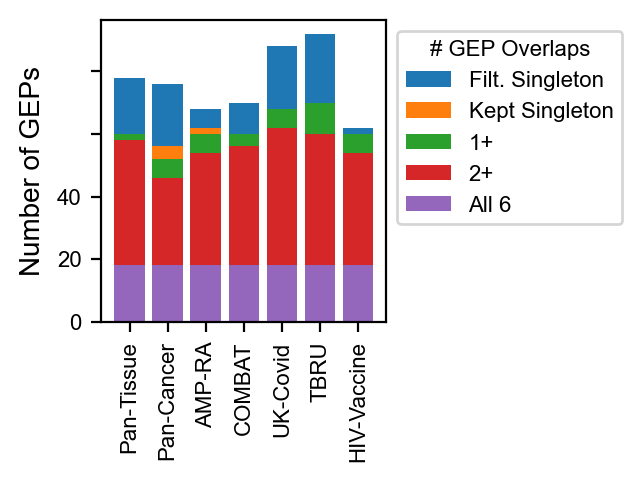

In [80]:
(fig, ax) = plt.subplots(1,1, figsize=(3,2), dpi=200, gridspec_kw={'right':.6})
ax.bar(x=dataset_overlap_res.index, height=dataset_overlap_res.sum(axis=1), label='Filt. Singleton')
ax.bar(x=dataset_overlap_res.index, height=dataset_overlap_res.iloc[:, 1:].sum(axis=1), label='Kept Singleton')
ax.bar(x=dataset_overlap_res.index, height=dataset_overlap_res.iloc[:, 2:].sum(axis=1), label='1+')
ax.bar(x=dataset_overlap_res.index, height=dataset_overlap_res.iloc[:, 3:].sum(axis=1), label='2+')
ax.bar(x=dataset_overlap_res.index, height=dataset_overlap_res.iloc[:, 7], label='All 6')
ax.set_xticklabels(dataset_overlap_res.index, rotation=90, fontsize=8)
ax.set_yticklabels([0, 20, 40], fontsize=8)

ax.set_ylabel('Number of GEPs', fontsize=10)
#ax.set_xlabel('Dataset', fontsize=10)
ax.legend(bbox_to_anchor=(1,1), title='# GEP Overlaps', fontsize=8, title_fontsize=8)
# plt.savefig('../../Figures/Components/GEP_Overlap_Barplot_Summary.png', bbox_inches='tight')
# plt.savefig('../../Figures/Components/GEP_Overlap_Barplot_Summary.pdf', bbox_inches='tight')